Problem statement: what are you investigating about? <br>
Dataset: describe the dataset <br>
Pseudocode to answer the question(s) you have that are about how to analyze the data <br>
Partial code: Python code you have so far as a team <br>
AI comparison: What have you accomplished so far regarding this task?<br>
Team members' work: description of what each team member has done for the project and the percentage of the contribution to the teamwork (total team work is 100%; if members have contributed equally, each member will have 25% for a team of four, 20% for a team of five)<br>

## Problem Statement:
Between 2012 and 2024, Tempe, Arizona has recorded a concerning number of car accidents, many of which have resulted in fatalities. While traffic collisions occur throughout the city, certain intersections appear to be consistently more dangerous than others, contributing disproportionately to the number of deaths. Despite ongoing efforts to improve roadway safety, there has been limited research into why some intersections in Tempe are deadlier than others. This study focuses on examining the relationship between the number of deaths caused by car accidents and the characteristics of specific intersections in Tempe during the period from 2012 to 2024. By identifying patterns and high-risk locations, the research aims to provide insights that can guide evidence based interventions and improve traffic safety.


### We will attempt to answer the following questions:

- How are accidents distributed by severity (high, middle, low)? <br>
- What are the characteristics of intersections where accidents occur?
    - Location
    - Direction (East/West, North/South)
- What are the characteristics of the accidents that occur?
    - Weather <br>
    - Time of day <br>
    - Usage of substances <br>
- What is the correlation between traffic intersections and severe car accidents?

## Dataset
The dataset originates from the Arizona Department of Transportation (ADOT).
It is prepared by sorting raw crash records to remove sensitive information such as license plate numbers.
The sanitized data is then published manually, approximately semi‑annually. This dataset documents high‑severity traffic crashes—specifically fatal and serious injury crashes—within the City of Tempe, Arizona.
It includes vehicle-on-vehicle, vehicle-on-bicycle, and vehicle-on-pedestrian incidents, detailing the type of crash and where it occurred.
It’s used by Tempe’s Engineering and Transportation Department to support Vision Zero, with the goal of reducing preventable high-severity crashes to zero.


# Pseudocode

- Open file
- Clean names
- Visualize accident distribution - map, pareto chart, intersection bar, tables, etc
- New field severity groups
- Visualize accident distribution by severity - map, histogram, tables, etc
- For each intersection characteristic/severity group df - pearson correlation, others?
- Compare differences across severity groups


## Questions for Psuedocode
- How are accidents distributed by severity (high, middle, low)? <br>
- What are the characteristics of intersections where accidents occur?
    - Location
    - Direction (East/West, North/South)
- What are the characteristics of the accidents that occur?
    - Weather <br>
    - Time of day <br>
    - Usage of substances <br>
- What is the correlation between traffic intersections and severe car accidents?
## ---------------------------------------------------------------------
- What is the relationship between location of intersections and number of fatalities?
- Does the direction of the streets (East/West, North/South) have any correlation with the number of fatalities at intersections?
- Does the time of day affect when fatal accidents occur?


### From Josh
- How are all accidents distributed?
- How are accidents distributed by severity (high, middle, low)?
- What are the characteristics of intersections where accidents occur by severity?
- What are the differences between them?
- Do any particular/changeable characteristics seem to increase/decrease severity?

### From Ishan
- Does the hour of the day affect the likelihood of an accident?
- Does the trend of fatality match with the likelihood that an accident is going to occur at certain hour of the day.
- Is it multiple intersections of a particular street that experience high accidents or fatalities? What could be reasons for that?
- Do the top driver violations for high accidents also correspond to high fatality?
- Does Unitaction_One and accidents have any correlation? Did a particular action turn out to be more fatal?

#### Pseudo code ^^
- Open file
- Clean names
- Visualize accident distribution - map, pareto chart, intersection bar, tables, etc
- New field severity groups
- Visualize accident distribution by severity - map, histogram, tables, etc
- For each intersection characteristic/severity group df - pearson correlation, others?
- Compare differences across severity groups

# Partial Code

### Open File

In [84]:
# enable many obj dumps in a cell w/out print
#from IPython.core.interactiveshell import InteractiveShell 
#InteractiveShell.ast_node_interactivity = 'all'

import pandas as pd
pd.set_option('display.max_columns', None)

# prep google flag
GOOGLE = False

def prepGoogle() :
    try:
        from google.colab import drive
        drive.mount('/content/drive')

    except ModuleNotFoundError:
        print("Are you sure you want to use Google? Can't find module.")


if GOOGLE :
    prepGoogle()
    file_path = '/content/drive/MyDrive/1.08_Crash_Data_Report_(detail).csv'
else : 
    file_path = 'data.csv'
    

df = pd.read_csv(file_path)
display(df.tail(2))

,X,Y,OBJECTID,Incidentid,DateTime,Year,StreetName,CrossStreet,Distance,JunctionRelation,Totalinjuries,Totalfatalities,Injuryseverity,Collisionmanner,Lightcondition,Weather,SurfaceCondition,Unittype_One,Age_Drv1,Gender_Drv1,Traveldirection_One,Unitaction_One,Violation1_Drv1,AlcoholUse_Drv1,DrugUse_Drv1,Unittype_Two,Age_Drv2,Gender_Drv2,Traveldirection_Two,Unitaction_Two,Violation1_Drv2,AlcoholUse_Drv2,DrugUse_Drv2,Latitude,Longitude
51303,-111.926404,33.435576,51304,4155885.0,2024/03/14 13:20:00+00,2024.0,SR-202 Exit 7 T-Ramp,NaN,0.0,Entrance Exit Ramp 205,0.0,0.0,No Injury,Rear End,Daylight,Clear,Dry,Driver,40.0,Male,East,Making Right Turn,Followed Too Closely,No Apparent Influence,No Apparent Influence,Driver,25.0,Female,West,Making Right Turn,No Improper Action,No Apparent Influence,No Apparent Influence,33.435576,-111.926404
51304,-111.909869,33.436621,51305,4155890.0,2024/03/15 07:11:00+00,2024.0,SR-202 Exit 8 J-Ramp,NaN,0.0,Entrance Exit Ramp 205,0.0,0.0,No Injury,Single Vehicle,Dark Lighted,Clear,Dry,Driver,26.0,Male,North,Making Left Turn,Speed To Fast For Conditions,No Apparent Influence,No Apparent Influence,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.436621,-111.909869


### Clean File

#### Rename Fields

In [85]:
explicit_column_map = {
    "X": "x",
    "Y": "y",
    "OBJECTID": "object_id",
    "Incidentid": "incident_id",
    "DateTime": "date_time",
    "Year": "year",
    "StreetName": "street_name",
    "CrossStreet": "cross_street",
    "Distance": "distance",
    "JunctionRelation": "junction_relation",
    "Totalinjuries": "total_injuries",
    "Totalfatalities": "total_fatalities",
    "Injuryseverity": "injury_severity",
    "Collisionmanner": "collision_manner",
    "Lightcondition": "light_condition",
    "Weather": "weather",
    "SurfaceCondition": "surface_condition",
    "Unittype_One": "unit_type_1",
    "Age_Drv1": "age_1",
    "Gender_Drv1": "gender_1",
    "Traveldirection_One": "travel_direction_1",
    "Unitaction_One": "unit_action_1",
    "Violation1_Drv1": "violation_1",
    "AlcoholUse_Drv1": "alcohol_use_1",
    "DrugUse_Drv1": "drug_use_1",
    "Unittype_Two": "unit_type_2",
    "Age_Drv2": "age_2",
    "Gender_Drv2": "gender_2",
    "Traveldirection_Two": "travel_direction_2",
    "Unitaction_Two": "unit_action_2",
    "Violation1_Drv2": "violation_2",
    "AlcoholUse_Drv2": "alcohol_use_2",
    "DrugUse_Drv2": "drug_use_2",
    "Latitude": "lat",
    "Longitude": "long"
}

# Rename using the dictionary
df.rename(columns=explicit_column_map, inplace=True)
display(df.tail(2))

,x,y,object_id,incident_id,date_time,year,street_name,cross_street,distance,junction_relation,total_injuries,total_fatalities,injury_severity,collision_manner,light_condition,weather,surface_condition,unit_type_1,age_1,gender_1,travel_direction_1,unit_action_1,violation_1,alcohol_use_1,drug_use_1,unit_type_2,age_2,gender_2,travel_direction_2,unit_action_2,violation_2,alcohol_use_2,drug_use_2,lat,long
51303,-111.926404,33.435576,51304,4155885.0,2024/03/14 13:20:00+00,2024.0,SR-202 Exit 7 T-Ramp,NaN,0.0,Entrance Exit Ramp 205,0.0,0.0,No Injury,Rear End,Daylight,Clear,Dry,Driver,40.0,Male,East,Making Right Turn,Followed Too Closely,No Apparent Influence,No Apparent Influence,Driver,25.0,Female,West,Making Right Turn,No Improper Action,No Apparent Influence,No Apparent Influence,33.435576,-111.926404
51304,-111.909869,33.436621,51305,4155890.0,2024/03/15 07:11:00+00,2024.0,SR-202 Exit 8 J-Ramp,NaN,0.0,Entrance Exit Ramp 205,0.0,0.0,No Injury,Single Vehicle,Dark Lighted,Clear,Dry,Driver,26.0,Male,North,Making Left Turn,Speed To Fast For Conditions,No Apparent Influence,No Apparent Influence,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.436621,-111.909869


#### Fix Data Types

In [86]:
# Convert types with error handling and timezone removal for datetime
df['date_time'] = pd.to_datetime(df['date_time'], errors='coerce').dt.tz_localize(None)

# Type conversion map
dtype_map = {
    'x': 'float',
    'y': 'float',
    'object_id': 'Int64',
    'incident_id': 'Int64',
    'year': 'Int64',
    'street_name': 'string',
    'cross_street': 'string',
    'distance': 'float',
    'junction_relation': 'string',
    'total_injuries': 'Int64',
    'total_fatalities': 'Int64',
    'injury_severity': 'string',
    'collision_manner': 'string',
    'light_condition': 'string',
    'weather': 'string',
    'surface_condition': 'string',
    'unit_type_1': 'string',
    'age_1': 'Int64',
    'gender_1': 'string',
    'travel_direction_1': 'string',
    'unit_action_1': 'string',
    'violation_1': 'string',
    'alcohol_use_1': 'string',
    'drug_use_1': 'string',
    'unit_type_2': 'string', 
    'age_2': 'Int64',
    'gender_2': 'string',
    'travel_direction_2': 'string',
    'unit_action_2': 'string',
    'violation_2': 'string',
    'alcohol_use_2': 'string',
    'drug_use_2': 'string',
    'lat': 'float',
    'long': 'float'
}

# Apply conversions
for col, dtype in dtype_map.items():
    df[col] = df[col].astype(dtype, errors='ignore')

display(df.dtypes)

x                            float64
y                            float64
object_id                      Int64
incident_id                    Int64
date_time             datetime64[ns]
year                           Int64
street_name                   string
cross_street                  string
distance                     float64
junction_relation             string
total_injuries                 Int64
total_fatalities               Int64
injury_severity               string
collision_manner              string
light_condition               string
weather                       string
surface_condition             string
unit_type_1                   string
age_1                          Int64
gender_1                      string
travel_direction_1            string
unit_action_1                 string
violation_1                   string
alcohol_use_1                 string
drug_use_1                    string
unit_type_2                   string
age_2                          Int64
g

#### Create Convenience Fields

In [87]:
# Separate date elements
df['date'] = df['date_time'].dt.date
df['month'] = df['date_time'].dt.month
df['day'] = df['date_time'].dt.day

# Parse out time and hour
df['time'] = df['date_time'].dt.time
df['hour'] = pd.to_datetime(df['time'], format='%H:%M:%S').dt.hour

# create an intersection field
df["intersection"] = df.apply(
    lambda row: f"{row['street_name']} & {row['cross_street']}"
    if pd.notna(row["street_name"]) and pd.notna(row["cross_street"]) else pd.NA,
    axis=1
)

display(df.head(2))
display(df.tail(2))

,x,y,object_id,incident_id,date_time,year,street_name,cross_street,distance,junction_relation,total_injuries,total_fatalities,injury_severity,collision_manner,light_condition,weather,surface_condition,unit_type_1,age_1,gender_1,travel_direction_1,unit_action_1,violation_1,alcohol_use_1,drug_use_1,unit_type_2,age_2,gender_2,travel_direction_2,unit_action_2,violation_2,alcohol_use_2,drug_use_2,lat,long,date,month,day,time,hour,intersection
0,-111.95221,33.42191,1,2598369,2012-01-01 07:25:00,2012,University Dr,Hardy Dr,0.00,Intersection Non Interchange,6,0,Non Incapacitating Injury,ANGLE (Front To Side)(Other Than Left Turn),Dark Lighted,Clear,Dry,Driver,23,Female,West,Making Left Turn,Inattention Distraction,Alcohol,No Apparent Influence,Driver,20,Female,East,Going Straight Ahead,No Improper Action,No Apparent Influence,No Apparent Influence,33.42191,-111.95221,2012-01-01,1.0,1.0,07:25:00,7.0,University Dr & Hardy Dr
1,-111.93769,33.42319,2,2593420,2012-01-01 11:45:00,2012,7th St,Myrtle Ave,139.92,Not Junction Related,0,0,No Injury,Single Vehicle,Dark Lighted,Clear,Dry,Driver,255,<NA>,East,Backing,Unknown,No Apparent Influence,No Apparent Influence,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,33.42319,-111.93769,2012-01-01,1.0,1.0,11:45:00,11.0,7th St & Myrtle Ave


,x,y,object_id,incident_id,date_time,year,street_name,cross_street,distance,junction_relation,total_injuries,total_fatalities,injury_severity,collision_manner,light_condition,weather,surface_condition,unit_type_1,age_1,gender_1,travel_direction_1,unit_action_1,violation_1,alcohol_use_1,drug_use_1,unit_type_2,age_2,gender_2,travel_direction_2,unit_action_2,violation_2,alcohol_use_2,drug_use_2,lat,long,date,month,day,time,hour,intersection
51303,-111.926404,33.435576,51304,4155885,2024-03-14 13:20:00,2024,SR-202 Exit 7 T-Ramp,<NA>,0.0,Entrance Exit Ramp 205,0,0,No Injury,Rear End,Daylight,Clear,Dry,Driver,40,Male,East,Making Right Turn,Followed Too Closely,No Apparent Influence,No Apparent Influence,Driver,25,Female,West,Making Right Turn,No Improper Action,No Apparent Influence,No Apparent Influence,33.435576,-111.926404,2024-03-14,3.0,14.0,13:20:00,13.0,<NA>
51304,-111.909869,33.436621,51305,4155890,2024-03-15 07:11:00,2024,SR-202 Exit 8 J-Ramp,<NA>,0.0,Entrance Exit Ramp 205,0,0,No Injury,Single Vehicle,Dark Lighted,Clear,Dry,Driver,26,Male,North,Making Left Turn,Speed To Fast For Conditions,No Apparent Influence,No Apparent Influence,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,33.436621,-111.909869,2024-03-15,3.0,15.0,07:11:00,7.0,<NA>


### Visualize Accident Distribution

#### Junction Relation

Not Junction Related                    17049
Intersection Related Non Interchange     7880
Intersection Related 206                 5997
Intersection Non Interchange             5965
Intersection 4 Way 202                   3351
Driveway                                 1900
Driveway Or Alley                        1878
Intersection Interchange                 1199
206                                      1025
Intersection Related Interchange         1025
Intersection T Inter 203                 1006
Intersection 201                          665
202                                       471
Entrance Exit Ramp 205                    374
201                                       271
Unknown                                   254
Thru Roadway                              207
203                                       142
Railway Grade Crossing                    113
Intersection Other 204                     96
Frontage Road Interchange                  93
Entrance Exit Ramp Interchange    

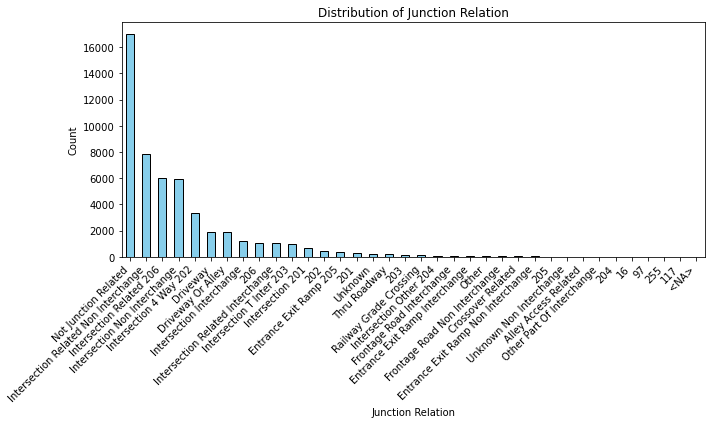

In [88]:
display(df['junction_relation'].value_counts(dropna=False))

import matplotlib.pyplot as plt

# Count values
junction_counts = df['junction_relation'].value_counts(dropna=False)

# Plot
plt.figure(figsize=(10, 6))
junction_counts.plot(kind='bar', color='skyblue', edgecolor='black')

# Style
plt.title('Distribution of Junction Relation')
plt.xlabel('Junction Relation')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

#### Let's only include accidents marked as having occurred at/caused by interchanges

In [89]:
# comment out values we're not interested in
interesting_values = [
#    'Not Junction Related',                 #17049
    'Intersection Related Non Interchange', # 7880
    'Intersection Related 206',             # 5997
    'Intersection Non Interchange',         # 5965
    'Intersection 4 Way 202',               # 3351
#    'Driveway',                             # 1900
#    'Driveway Or Alley',                    # 1878
    'Intersection Interchange',             # 1199
    '206',                                  # 1025
    'Intersection Related Interchange',     # 1025
    'Intersection T Inter 203',             # 1006
    'Intersection 201',                     #  665
    '202',                                  #  471
    'Entrance Exit Ramp 205',               #  374
    '201',                                  #  271
#    'Unknown',                              #  254
#    'Thru Roadway',                         #  207
    '203',                                  #  142
#    'Railway Grade Crossing',               #  113
    'Intersection Other 204',               #   96
    'Frontage Road Interchange',            #   93
    'Entrance Exit Ramp Interchange',       #   69
    'Other',                                #   57
#    'Frontage Road Non Interchange',        #   32
    'Crossover Related',                    #   29
    'Entrance Exit Ramp Non Interchange',   #   28
    '205',                                  #   26
    'Unknown Non Interchange',              #   26
    'Alley Access Related',                 #   26
    'Other Part Of Interchange',            #   15
    '204',                                  #   13
    '16',                                   #    8
    '97',                                   #    8
    '255',                                  #    3
    '117',                                  #    2
    '<NA>'                                  #    2
]                               

checkpoint_df = {}
checkpoint_df['junctions'] = df.copy(deep=True)

df = df[df['junction_relation'].isin(interesting_values)].copy(deep=True)
display(len(df))
display(len(checkpoint_df))

29870

1

#### Pareto Chart

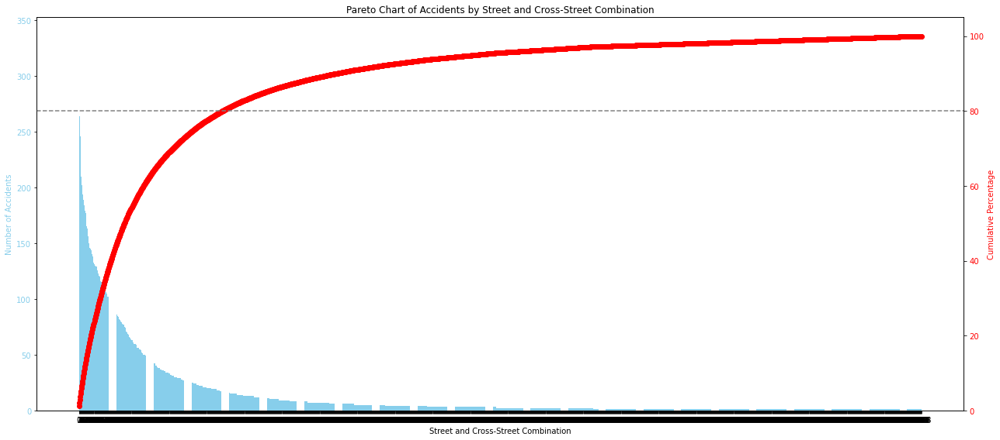

In [90]:
import matplotlib.pyplot as plt

# Make a pareto chart of accidents by street and cross-street combinations
# Sort the accidents by intersection data by accident count in descending order
accidents_by_intersection = df.groupby(['intersection']).size().reset_index(name='accident_count')
#accidents_by_intersection = accidents_by_intersection[accidents_by_intersection['accident_count'] >= 100]
accidents_by_intersection_sorted = accidents_by_intersection.sort_values(by='accident_count', ascending=False).reset_index(drop=True)

# Calculate the cumulative sum and cumulative percentage
accidents_by_intersection_sorted['cumulative_count'] = accidents_by_intersection_sorted['accident_count'].cumsum()
accidents_by_intersection_sorted['cumulative_percentage'] = (accidents_by_intersection_sorted['cumulative_count'] / accidents_by_intersection_sorted['accident_count'].sum()) * 100

# Create the Pareto chart
fig, ax1 = plt.subplots(figsize=(18, 8))

# Bar chart for accident counts
ax1.bar(accidents_by_intersection_sorted.index, accidents_by_intersection_sorted['accident_count'], color='skyblue')
ax1.set_xlabel('Street and Cross-Street Combination')
ax1.set_ylabel('Number of Accidents', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.set_title('Pareto Chart of Accidents by Street and Cross-Street Combination')
ax1.set_xticks(accidents_by_intersection_sorted.index)
#ax1.set_xticklabels(accidents_by_intersection_sorted['intersection'], rotation=90, ha='right')


# Line chart for cumulative percentage
ax2 = ax1.twinx()
ax2.plot(accidents_by_intersection_sorted.index, accidents_by_intersection_sorted['cumulative_percentage'], color='red', marker='o', linestyle='-')
ax2.set_ylabel('Cumulative Percentage', color='red')
ax2.tick_params(axis='y', labelcolor='red')
ax2.set_ylim(0, 105)

# Add a line at 80%
ax2.axhline(y=80, color='gray', linestyle='--')

plt.tight_layout()
plt.show()

#### Map

In [91]:
# get counts 
accidents_by_intersection = df.groupby(['intersection']).size().reset_index(name='accident_count')

# add perc
# Add percent of total
accidents_by_intersection['percent_of_total'] = (
    accidents_by_intersection['accident_count'] / accidents_by_intersection['accident_count'].sum()
) * 100


accidents_by_intersection = accidents_by_intersection.sort_values(
    by='percent_of_total', ascending=False)

display(accidents_by_intersection)

,intersection,accident_count,percent_of_total
1481,Price Rd & Broadway Rd,336,1.139060
399,Broadway Rd & Price Rd,264,0.894976
1749,Rural Rd & University Dr,252,0.854295
307,Baseline Rd & Kyrene Rd,246,0.833955
326,Baseline Rd & Wendler Dr,228,0.772934
...,...,...,...
787,George Dr & Geneva Dr,1,0.003390
786,Geneva Dr & Rural Rd,1,0.003390
785,Geneva Dr & Mill Ave,1,0.003390
784,Geneva Dr & Jentilly Ln,1,0.003390


In [1]:
# Get unique street and cross-street combinations with their coordinates
intersection_coordinates = df[['intersection', 'lat', 'long']].drop_duplicates()

# Merge the accident counts with the intersection coordinates
merged_intersections_with_coords = pd.merge(accidents_by_intersection, intersection_coordinates, on=['intersection'], how='inner')

# Drop rows with missing coordinates
merged_intersections_with_coords.dropna(subset=['lat', 'long'], inplace=True)

#!pip install folium
import folium
from folium.plugins import HeatMap

# Calculate the average latitude and longitude
center_lat = merged_intersections_with_coords['lat'].mean()
center_lon = merged_intersections_with_coords['long'].mean()

# Create a Folium map object
m = folium.Map(location=[center_lat, center_lon], zoom_start=14)


# Display the resulting DataFrame
# display(merged_intersections_with_coords.head())

# Define a color scale based on accident count
def get_color(count):
    if count >= .75:
        return 'red'
    elif count >= .5:
        return 'orange'
    elif count >= .25:
        return 'yellow'
    else:
        return 'green'

# Define marker size based on accident count
def get_size(count):
    return count * 5 # Scale size proportionally, with a minimum size

# Add markers to the map
for index, row in merged_intersections_with_coords.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=get_size(row['percent_of_total']),
        color=get_color(row['percent_of_total']),
        fill=True,
        fill_color=get_color(row['percent_of_total']),
        fill_opacity=0.6,
        tooltip=f"Intersection: {row['intersection']}<br>Accidents: {int(row['accident_count'])}"
    ).add_to(m)

# Display the map with markers
display(m)

NameError: name 'df' is not defined

#### Let's take intersections that were plotted orange or worst

In [94]:
top_intersections = accidents_by_intersection[accidents_by_intersection['percent_of_total'] >= .5]

display(top_intersections)
#display(len(top_intersections))

checkpoint_df['top_intersections'] = df.copy(deep=True)

df = df[df['intersection'].isin(top_intersections['intersection'])].copy(deep=True)


,intersection,accident_count,percent_of_total
1481,Price Rd & Broadway Rd,336,1.139060
399,Broadway Rd & Price Rd,264,0.894976
1749,Rural Rd & University Dr,252,0.854295
307,Baseline Rd & Kyrene Rd,246,0.833955
326,Baseline Rd & Wendler Dr,228,0.772934
2003,University Dr & Rural Rd,210,0.711913
1996,University Dr & Price Rd,203,0.688182
1690,Rural Rd & Apache Blvd,202,0.684792
1728,Rural Rd & Rio Salado Pkwy,195,0.661062
1686,Rural Rd & 6th St,194,0.657672


### Group By Severity Groups

### Visualize By Severity

### Correlations

### Differences by Severity Group

### Read Data and prepare data
### Plot visuals for number of accidents and fatalities per year

In [ ]:
# Extract the year from the 'DateTime' column
df['Year'] = df['DateTime'].dt.year

# Group by year and count the number of accidents
accidents_per_year = df['Year'].value_counts().sort_index()

# Display the results
print("Number of accidents per year:")
display(accidents_per_year)

Number of accidents per year:


,count
Year,
2012.0,4258
2013.0,4313
2014.0,4374
2015.0,4608
2016.0,4771
2017.0,4895
2018.0,5045
2019.0,5369
2020.0,2282


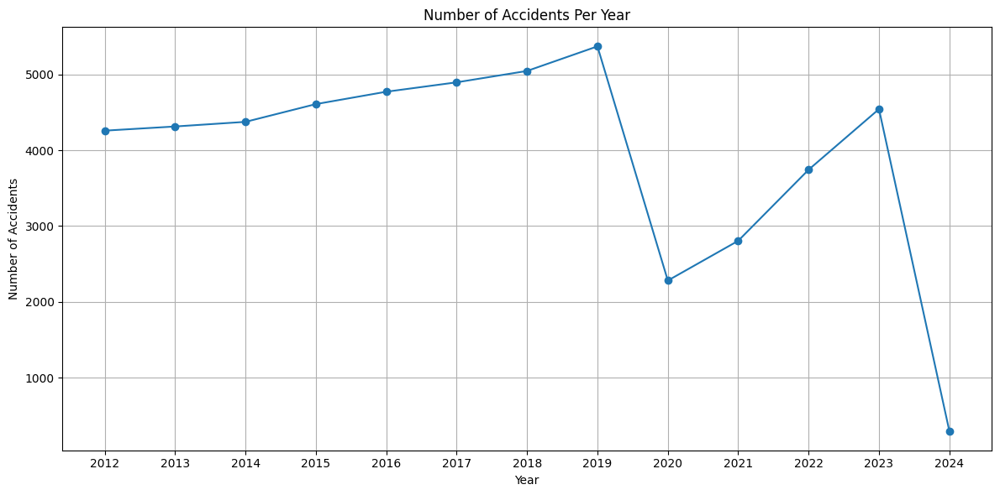

In [ ]:
import matplotlib.pyplot as plt

# Create a line plot for count of accidents per year
plt.figure(figsize=(12, 6))
plt.plot(accidents_per_year.index, accidents_per_year.values, marker='o', linestyle='-')
plt.title('Number of Accidents Per Year')
plt.xlabel('Year')
plt.ylabel('Number of Accidents')
plt.grid(True)
plt.xticks(accidents_per_year.index) # Ensure all years are shown on the x-axis
plt.tight_layout()
plt.show()

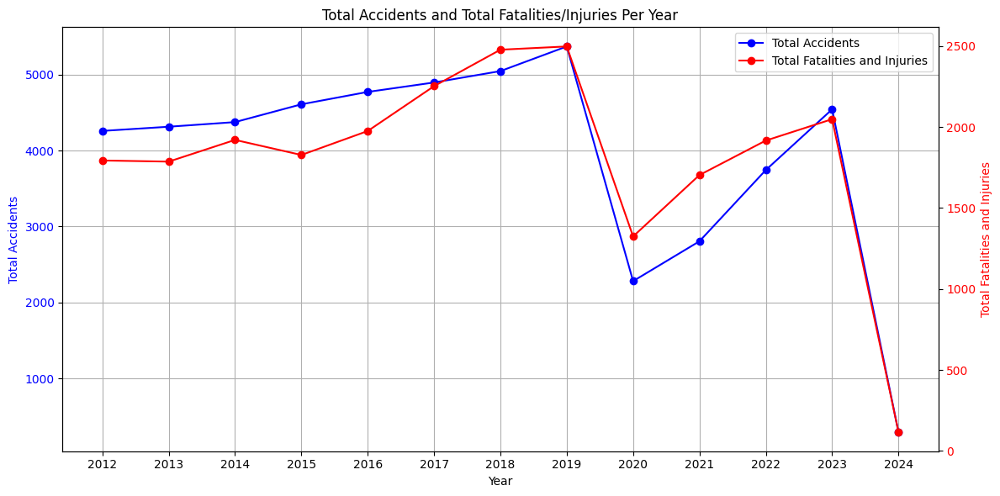

In [ ]:
# Trend of total accidents and injuries over years

import matplotlib.pyplot as plt

# Convert 'DateTime' to datetime objects and extract the year
df['DateTime'] = pd.to_datetime(df['DateTime'], errors='coerce')
df.dropna(subset=['DateTime'], inplace=True)
df['Year'] = df['DateTime'].dt.year

# Group by year and sum the total accidents, total fatalities, and total injuries
accidents_fatalities_injuries_per_year = df.groupby('Year').agg(
    total_accidents=('Incidentid', 'count'),
    total_fatalities=('Totalfatalities', 'sum'),
    total_injuries=('Totalinjuries', 'sum') # Summing total injuries
).reset_index()

# Calculate the sum of fatalities and injuries for the secondary axis
accidents_fatalities_injuries_per_year['total_fatalities_and_injuries'] = accidents_fatalities_injuries_per_year['total_fatalities'] + accidents_fatalities_injuries_per_year['total_injuries']


# Create a figure and a primary axes
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot total accidents on the primary y-axis
ax1.plot(accidents_fatalities_injuries_per_year['Year'], accidents_fatalities_injuries_per_year['total_accidents'], marker='o', linestyle='-', label='Total Accidents', color='blue')
ax1.set_xlabel('Year')
ax1.set_ylabel('Total Accidents', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')
ax1.grid(True)

# Create a secondary y-axis
ax2 = ax1.twinx()

# Plot total fatalities and injuries on the secondary y-axis
ax2.plot(accidents_fatalities_injuries_per_year['Year'], accidents_fatalities_injuries_per_year['total_fatalities_and_injuries'], marker='o', linestyle='-', label='Total Fatalities and Injuries', color='red')
ax2.set_ylabel('Total Fatalities and Injuries', color='red')
ax2.tick_params(axis='y', labelcolor='red')

# Set title and legends
plt.title('Total Accidents and Total Fatalities/Injuries Per Year')
fig.tight_layout() # Adjust layout to prevent labels overlapping

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc='upper right')


plt.xticks(accidents_fatalities_injuries_per_year['Year']) # Ensure all years are shown on the x-axis
plt.show()

## Task
Analyze the time series of accidents per year and per month using the dataset "1.08_Crash_Data_Report_(detail).csv".

## Extract month

### Subtask:
Extract the month from the 'DateTime' column and create a new 'Month' column.


In [ ]:
# Separate month from DateTime

df['Month'] = df['DateTime'].dt.month
display(df.head())

,X,Y,OBJECTID,Incidentid,DateTime,Year,StreetName,CrossStreet,Distance,JunctionRelation,...,Traveldirection_Two,Unitaction_Two,Violation1_Drv2,AlcoholUse_Drv2,DrugUse_Drv2,Latitude,Longitude,Date,Time,Month
0,-111.95221,33.42191,1,2598369.0,2012-01-01 07:25:00+00:00,2012,University Dr,Hardy Dr,0.000,Intersection Non Interchange,...,East,Going Straight Ahead,No Improper Action,No Apparent Influence,No Apparent Influence,33.42191,-111.95221,2012-01-01,07:25:00,1
1,-111.93769,33.42319,2,2593420.0,2012-01-01 11:45:00+00:00,2012,7th St,Myrtle Ave,139.920,Not Junction Related,...,NaN,NaN,NaN,NaN,NaN,33.42319,-111.93769,2012-01-01,11:45:00,1
2,-111.89196,33.41842,3,2588493.0,2012-01-01 18:07:00+00:00,2012,Price Rd,Orange St,0.000,Intersection Interchange,...,South,Going Straight Ahead,No Improper Action,No Apparent Influence,No Apparent Influence,33.41842,-111.89196,2012-01-01,18:07:00,1
3,-111.94791,33.41779,4,2584449.0,2012-01-02 00:03:00+00:00,2012,11th St,Judd St,200.112,Not Junction Related,...,East,Properly Parked,NaN,NaN,NaN,33.41779,-111.94791,2012-01-02,00:03:00,1
4,-111.92847,33.34956,5,2592211.0,2012-01-02 00:12:00+00:00,2012,Rural Rd,Elliot Rd,135.168,Intersection Related Non Interchange,...,South,Going Straight Ahead,No Improper Action,No Apparent Influence,No Apparent Influence,33.34956,-111.92847,2012-01-02,00:12:00,1


## Group and count

### Subtask:
Group the DataFrame by 'Year' and 'Month', and count the number of accidents for each group.


**Reasoning**:

---


Group the DataFrame by 'Year' and 'Month' and count the number of accidents for each group, then display the results.


In [ ]:
# accident by year and month
accidents_per_month = df.groupby(['Year', 'Month']).size().reset_index(name='count')
print("Number of accidents per year and month:")
display(accidents_per_month)

Number of accidents per year and month:


,Year,Month,count
0,2012,1,362
1,2012,2,385
2,2012,3,377
3,2012,4,324
4,2012,5,355
...,...,...,...
142,2023,11,364
143,2023,12,352
144,2024,1,235
145,2024,2,51


### Visualize monthly accident trends over years

## Pivot table

### Subtask:
Create a pivot table with 'Year' as rows, 'Month' as columns, and the accident counts as values.


**Reasoning**:
Create a pivot table from the accidents_per_month DataFrame with 'Year' as index, 'Month' as columns, and 'count' as values, then display the pivot table.



In [ ]:
accidents_pivot = accidents_per_month.pivot(index='Year', columns='Month', values='count')
display(accidents_pivot)

Month,1,2,3,4,5,6,7,8,9,10,11,12
Year,,,,,,,,,,,,
2012,362.0,385.0,377.0,324.0,355.0,299.0,279.0,368.0,376.0,382.0,406.0,345.0
2013,351.0,380.0,378.0,384.0,334.0,288.0,275.0,376.0,370.0,445.0,381.0,351.0
2014,368.0,347.0,410.0,425.0,362.0,297.0,251.0,365.0,337.0,426.0,408.0,378.0
2015,393.0,389.0,413.0,399.0,380.0,322.0,312.0,366.0,405.0,437.0,410.0,382.0
2016,404.0,401.0,439.0,419.0,356.0,301.0,288.0,420.0,476.0,456.0,441.0,370.0
2017,445.0,458.0,485.0,412.0,337.0,287.0,286.0,436.0,496.0,461.0,436.0,356.0
2018,402.0,439.0,423.0,421.0,389.0,341.0,349.0,449.0,449.0,496.0,482.0,405.0
2019,482.0,468.0,432.0,488.0,398.0,334.0,366.0,473.0,513.0,502.0,455.0,458.0
2020,399.0,376.0,268.0,105.0,165.0,109.0,112.0,139.0,186.0,165.0,115.0,143.0


## Visualize data

### Subtask:
Generate a plot to visualize the time series of accidents per month, with each month represented by a separate line.


**Reasoning**:
Generate a line plot to visualize the monthly accident trends over time using the pivoted data.



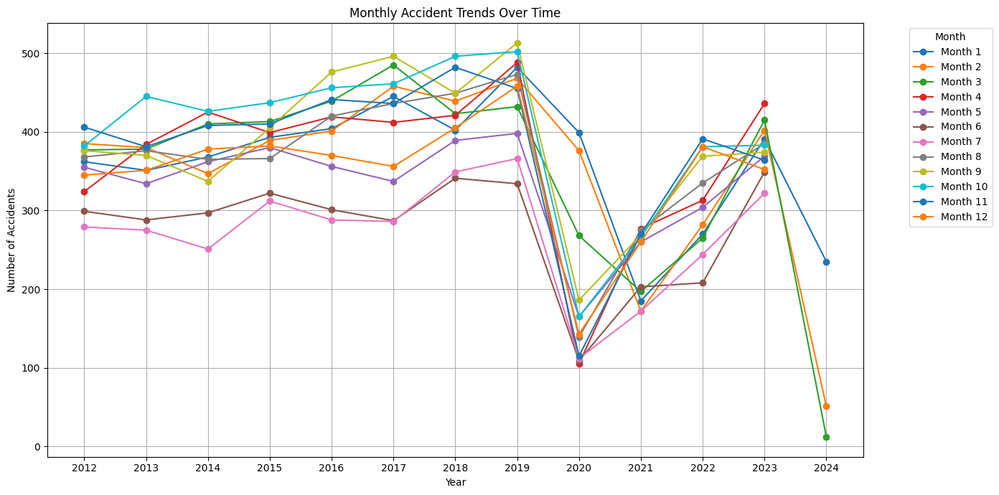

In [ ]:
plt.figure(figsize=(14, 7))
for month in accidents_pivot.columns:
    plt.plot(accidents_pivot.index, accidents_pivot[month], marker='o', linestyle='-', label=f'Month {int(month)}')

plt.title('Monthly Accident Trends Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Accidents')
plt.grid(True)
plt.xticks(accidents_pivot.index)
plt.legend(title='Month', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

### Plot number of accidents by hour
### Plot street combinations with most accidents
### Make a pareto chart of most accidents by street combinations
### Find street combinations with most fatal injuries
### Find number of accidents caused by influence of drugs or alcohol
### Plot Main violations by drivers



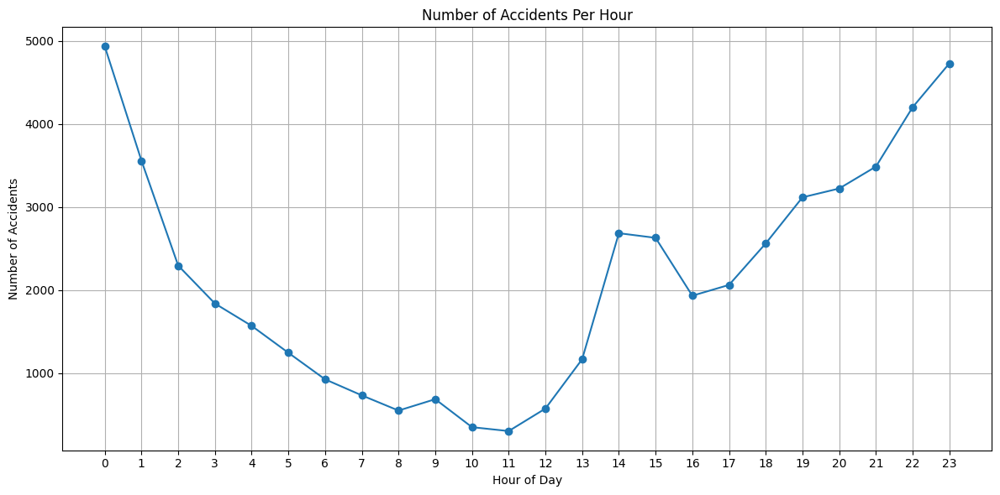

In [ ]:
# plot accidents by hour on a line graph
# Extract the hour from the 'Time' column
df['Hour'] = pd.to_datetime(df['Time'], format='%H:%M:%S').dt.hour

# Count the frequency of accidents per hour
accidents_per_hour = df['Hour'].value_counts().sort_index()

# Create a line plot
plt.figure(figsize=(12, 6))
plt.plot(accidents_per_hour.index, accidents_per_hour.values, marker='o', linestyle='-')
plt.title('Number of Accidents Per Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Accidents')
plt.xticks(range(24)) # Ensure all hours (0-23) are shown on the x-axis
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Find intersection with highest accidents
# Group by 'StreetName' and 'CrossStreet' and count the number of accidents
accidents_by_intersection = df.groupby(['StreetName', 'CrossStreet']).size().reset_index(name='accident_count')

# Sort by the accident count in descending order and get the top 10
top_10_intersections = accidents_by_intersection.sort_values(by='accident_count', ascending=False).head(20)

# Display the top 10 intersections
print("Top 20 StreetName and CrossStreet combinations with the most accidents:")
display(top_10_intersections)

Top 20 StreetName and CrossStreet combinations with the most accidents:


,StreetName,CrossStreet,accident_count
2270,Price Rd,Broadway Rd,435
2967,University Dr,Rural Rd,418
438,Baseline Rd,Kyrene Rd,408
2085,Mill Ave,Southern Ave,378
2598,Rural Rd,Southern Ave,377
2804,Southern Ave,Rural Rd,370
2558,Rural Rd,Broadway Rd,362
1899,McClintock Dr,Rio Salado Pkwy,361
573,Broadway Rd,Price Rd,360
579,Broadway Rd,Rural Rd,355


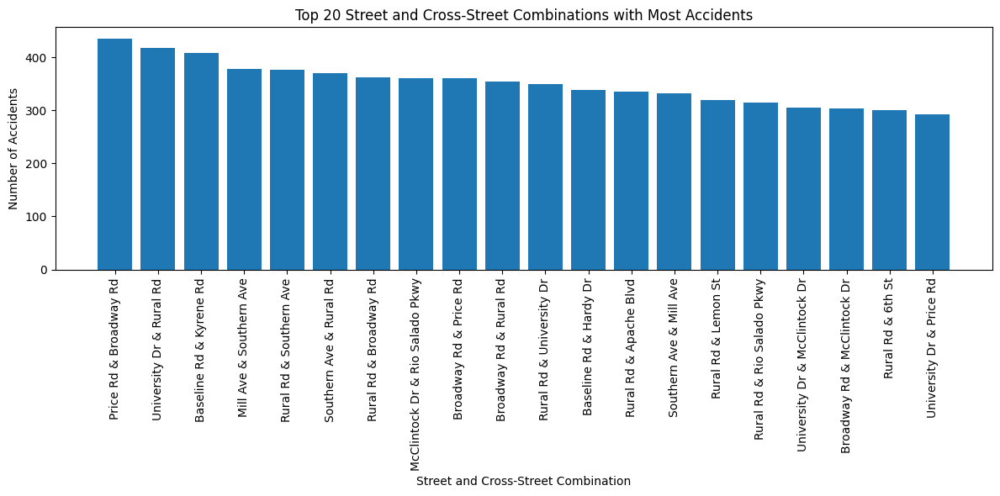

In [ ]:
# Plot top street combinations with most accidents on graph
import matplotlib.pyplot as plt

# Create a bar graph
plt.figure(figsize=(12, 6))
plt.bar(top_10_intersections['StreetName'] + ' & ' + top_10_intersections['CrossStreet'], top_10_intersections['accident_count'])
plt.title('Top 20 Street and Cross-Street Combinations with Most Accidents')
plt.xlabel('Street and Cross-Street Combination')
plt.ylabel('Number of Accidents')
plt.xticks(rotation=90) # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

In [ ]:
# Find the number of intersections that contribute to 80% of the accidents
# Sort the accidents by intersection data by accident count in descending order
accidents_by_intersection_sorted = accidents_by_intersection.sort_values(by='accident_count', ascending=False).reset_index(drop=True)

# Calculate the cumulative sum and cumulative percentage
accidents_by_intersection_sorted['cumulative_count'] = accidents_by_intersection_sorted['accident_count'].cumsum()
accidents_by_intersection_sorted['cumulative_percentage'] = (accidents_by_intersection_sorted['cumulative_count'] / accidents_by_intersection_sorted['accident_count'].sum()) * 100

# We look for the first row where the cumulative percentage is greater than or equal to 80%
# The index of this row + 1 gives us the number of intersections
num_intersections_80_percent = (accidents_by_intersection_sorted['cumulative_percentage'] >= 80).idxmax() + 1

print(f"The top {num_intersections_80_percent} street and cross-street combinations account for 80% of the accidents.")

The top 429 street and cross-street combinations account for 80% of the accidents.


In [ ]:
# Get the total number of unique street and cross-street combinations
total_intersections = len(accidents_by_intersection)

print(f"There are a total of {total_intersections} unique street and cross-street combinations in the dataset.")

There are a total of 3191 unique street and cross-street combinations in the dataset.


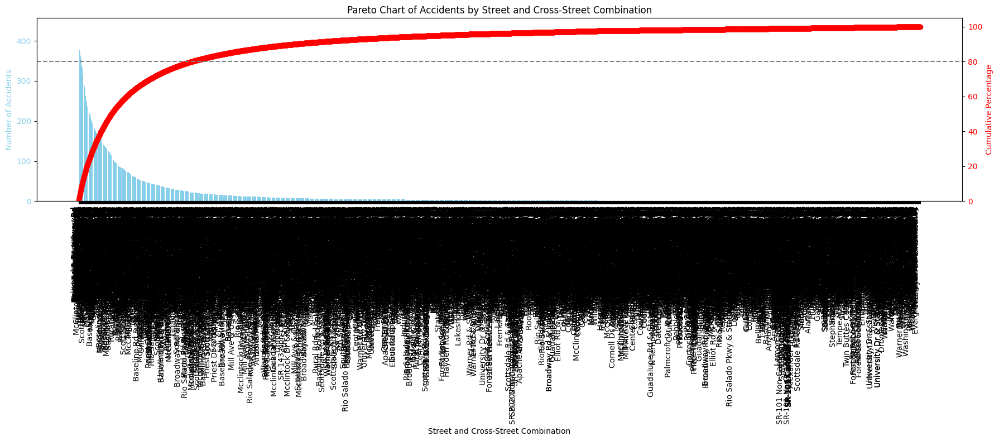

In [ ]:
# Make a pareto chart of accidents by street and cross-street combinations
# Sort the accidents by intersection data by accident count in descending order
accidents_by_intersection_sorted = accidents_by_intersection.sort_values(by='accident_count', ascending=False).reset_index(drop=True)

# Calculate the cumulative sum and cumulative percentage
accidents_by_intersection_sorted['cumulative_count'] = accidents_by_intersection_sorted['accident_count'].cumsum()
accidents_by_intersection_sorted['cumulative_percentage'] = (accidents_by_intersection_sorted['cumulative_count'] / accidents_by_intersection_sorted['accident_count'].sum()) * 100

# Create the Pareto chart
fig, ax1 = plt.subplots(figsize=(18, 8))

# Bar chart for accident counts
ax1.bar(accidents_by_intersection_sorted.index, accidents_by_intersection_sorted['accident_count'], color='skyblue')
ax1.set_xlabel('Street and Cross-Street Combination')
ax1.set_ylabel('Number of Accidents', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.set_title('Pareto Chart of Accidents by Street and Cross-Street Combination')
ax1.set_xticks(accidents_by_intersection_sorted.index)
ax1.set_xticklabels(accidents_by_intersection_sorted['StreetName'] + ' & ' + accidents_by_intersection_sorted['CrossStreet'], rotation=90, ha='right')


# Line chart for cumulative percentage
ax2 = ax1.twinx()
ax2.plot(accidents_by_intersection_sorted.index, accidents_by_intersection_sorted['cumulative_percentage'], color='red', marker='o', linestyle='-')
ax2.set_ylabel('Cumulative Percentage', color='red')
ax2.tick_params(axis='y', labelcolor='red')
ax2.set_ylim(0, 105)

# Add a line at 80%
ax2.axhline(y=80, color='gray', linestyle='--')

plt.tight_layout()
plt.show()

In [ ]:
# Find streetName and CrossStreet combinations with the most fatal injuries
# Group by 'StreetName' and 'CrossStreet' and sum the 'Totalfatalities'
fatalities_by_intersection = df.groupby(['StreetName', 'CrossStreet'])['Totalfatalities'].sum().reset_index(name='total_fatalities')

# Sort by the total fatalities in descending order
fatalities_by_intersection_sorted = fatalities_by_intersection.sort_values(by='total_fatalities', ascending=False)

# Display the intersections with the most fatal injuries (excluding those with 0 fatalities)
print("Street and Cross-Street combinations with the most fatal injuries:")
display(fatalities_by_intersection_sorted[fatalities_by_intersection_sorted['total_fatalities'] > 0])

Street and Cross-Street combinations with the most fatal injuries:


,StreetName,CrossStreet,total_fatalities
854,Curry Rd,College Ave,4.0
2776,Southern Ave,Hardy Dr,4.0
547,Broadway Rd,Hardy Dr,3.0
438,Baseline Rd,Kyrene Rd,3.0
447,Baseline Rd,Pointe Pkwy,3.0
...,...,...,...
2761,Southern Ave,48th St,1.0
2768,Southern Ave,College Ave,1.0
449,Baseline Rd,Price Rd Non-Cardinal,1.0
855,Curry Rd,E Lakeview Dr,1.0


In [ ]:
# Find number of accidents where driver was under the influence of drugs
Analyze the 'DrugUse_Drv1' column
print("Analysis of 'DrugUse_Drv1':")
display(df['DrugUse_Drv1'].value_counts(dropna=False))

print("\nAnalysis of 'DrugUse_Drv2':")
display(df['DrugUse_Drv2'].value_counts(dropna=False))

Analysis of 'DrugUse_Drv1':


,count
DrugUse_Drv1,
No Apparent Influence,50807
Drugs,449
NaN,48



Analysis of 'DrugUse_Drv2':


,count
DrugUse_Drv2,
No Apparent Influence,46531
NaN,4757
Drugs,16


In [ ]:
# Find number of accidents where driver was under the influence of alcohol
# Analyze the 'AlcoholUse_Drv1' column
print("Analysis of 'AlcoholUse_Drv1':")
display(df['AlcoholUse_Drv1'].value_counts(dropna=False))

print("\nAnalysis of 'AlcoholUse_Drv2':")
display(df['AlcoholUse_Drv2'].value_counts(dropna=False))

Analysis of 'AlcoholUse_Drv1':


,count
AlcoholUse_Drv1,
No Apparent Influence,48803
Alcohol,2453
NaN,48



Analysis of 'AlcoholUse_Drv2':


,count
AlcoholUse_Drv2,
No Apparent Influence,46414
NaN,4757
Alcohol,133


In [ ]:
# Main reasons for violations by driver causing accidents
# Analyze the 'Violation1_Drv1' column
print("Analysis of 'Violation1_Drv1':")
display(df['Violation1_Drv1'].value_counts(dropna=False))

print("\nAnalysis of 'Violation1_Drv2':")
display(df['Violation1_Drv2'].value_counts(dropna=False))

Analysis of 'Violation1_Drv1':


,count
Violation1_Drv1,
Speed To Fast For Conditions,15134
Failed To Yield Right Of Way,10452
Unsafe Lane Change,4104
Followed Too Closely,3722
Unknown,3702
Disregarded Traffic Signal,3539
Other,2860
Made Improper Turn,2182
Failed To Keep In Proper Lane,1549



Analysis of 'Violation1_Drv2':


,count
Violation1_Drv2,
No Improper Action,42924
NaN,4757
Unknown,2427
Other,270
Speed To Fast For Conditions,270
Failed To Yield Right Of Way,158
Unsafe Lane Change,129
Made Improper Turn,59
Followed Too Closely,54


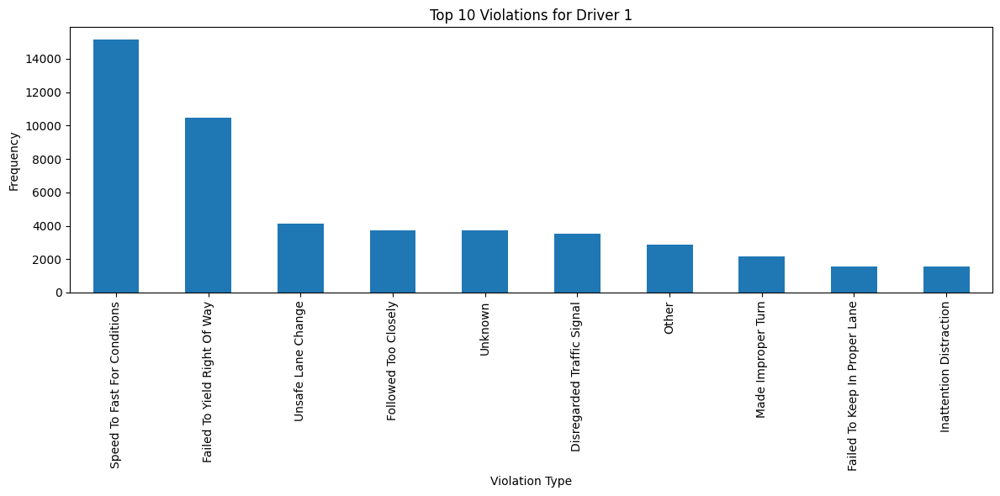

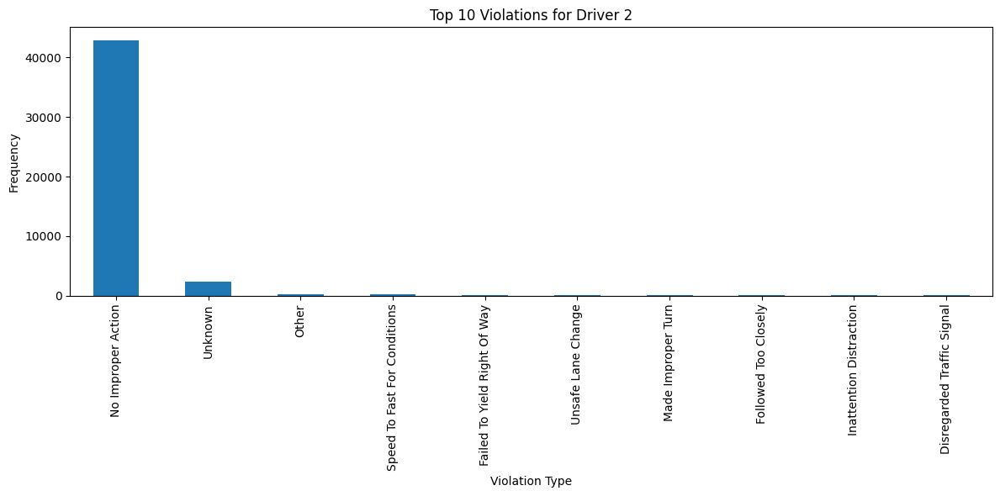

In [ ]:
# Plot the main driver violations causing accidents
import matplotlib.pyplot as plt

# Get the top 10 violations for Driver 1
top_10_violations_drv1 = df['Violation1_Drv1'].value_counts().head(10)

# Create a bar chart for top 10 violations for Driver 1
plt.figure(figsize=(12, 6))
top_10_violations_drv1.plot(kind='bar')
plt.title('Top 10 Violations for Driver 1')
plt.xlabel('Violation Type')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# Get the top 10 violations for Driver 2
top_10_violations_drv2 = df['Violation1_Drv2'].value_counts().head(10)

# Create a bar chart for top 10 violations for Driver 2
plt.figure(figsize=(12, 6))
top_10_violations_drv2.plot(kind='bar')
plt.title('Top 10 Violations for Driver 2')
plt.xlabel('Violation Type')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# Task
Create a color-coded map based on the provided coordinates, highlighting street and cross-street combinations with the highest number of accidents. Use a color scheme (red, orange, yellow, etc.) to indicate the frequency of accidents, with descriptions and larger labels for the most dangerous locations.

## Prepare data for mapping

### Subtask:
Aggregate accident data by street and cross-street combinations and ensure coordinates are available for these locations.


**Reasoning**:
Aggregate accident data by street and cross-street combinations, get unique coordinates for these combinations, and merge the data.



In [ ]:
# Group by 'StreetName' and 'CrossStreet' and count the number of accidents
accidents_by_intersection = df.groupby(['StreetName', 'CrossStreet']).size().reset_index(name='accident_count')

# Get unique street and cross-street combinations with their coordinates
intersection_coordinates = df[['StreetName', 'CrossStreet', 'Latitude', 'Longitude']].drop_duplicates()

# Merge the accident counts with the intersection coordinates
merged_intersections_with_coords = pd.merge(accidents_by_intersection, intersection_coordinates, on=['StreetName', 'CrossStreet'], how='inner')

# Drop rows with missing coordinates
merged_intersections_with_coords.dropna(subset=['Latitude', 'Longitude'], inplace=True)

# Display the resulting DataFrame
display(merged_intersections_with_coords.head())

,StreetName,CrossStreet,accident_count,Latitude,Longitude
0,10th Pl,52nd St,2,33.417530,-111.967830
1,10th Pl,52nd St,2,33.417531,-111.968227
2,10th Pl,Edward Dr,4,33.417540,-111.966440
3,10th Pl,Edward Dr,4,33.417540,-111.966210
4,10th Pl,Edward Dr,4,33.417534,-111.967436


### Make a color coded map for accidents by severity

## Choose a mapping library

### Subtask:
Select an appropriate Python library for creating interactive maps (e.g., Folium, Plotly Express).


## Create the base map

### Subtask:
Generate a base map centered around the area covered by the data using Folium.


**Reasoning**:
Generate a base map centered around the area covered by the data using Folium.



In [ ]:
import folium

# Calculate the average latitude and longitude
center_lat = merged_intersections_with_coords['Latitude'].mean()
center_lon = merged_intersections_with_coords['Longitude'].mean()

# Create a Folium map object
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Display the map
display(m)

## Add data to the map

### Subtask:
Add markers to the Folium map for each street and cross-street combination, using the accident count to determine the color and size of the markers.


**Reasoning**:
Add markers to the Folium map for each street and cross-street combination, using the accident count to determine the color and size of the markers.



In [ ]:
from folium.plugins import HeatMap

# Define a color scale based on accident count
def get_color(count):
    if count >= 100:
        return 'red'
    elif count >= 50:
        return 'orange'
    elif count >= 20:
        return 'yellow'
    else:
        return 'green'

# Define marker size based on accident count
def get_size(count):
    return count * 0.1 + 5 # Scale size proportionally, with a minimum size

# Add markers to the map
for index, row in merged_intersections_with_coords.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=get_size(row['accident_count']),
        color=get_color(row['accident_count']),
        fill=True,
        fill_color=get_color(row['accident_count']),
        fill_opacity=0.6,
        tooltip=f"Intersection: {row['StreetName']} & {row['CrossStreet']}<br>Accidents: {int(row['accident_count'])}"
    ).add_to(m)

# Display the map with markers
display(m)

## Summary:

### Data Analysis Key Findings

*   The analysis identified street and cross-street combinations with the highest number of accidents by grouping the data and counting occurrences.
*   Coordinates were successfully associated with each unique street and cross-street intersection where accidents occurred.
*   A color scale was implemented to represent accident frequency on the map: green for fewer accidents, yellow for moderate, orange for higher, and red for the highest frequency (100 or more accidents).
*   Marker size on the map was scaled proportionally to the accident count, with larger markers indicating a higher number of accidents.

### Insights or Next Steps

*   The created map visually highlights the most dangerous intersections, allowing for targeted safety interventions.


## AI Comparison

The proposed research questions are well-suited for this project. They focus on identifying the characteristics of intersections where crashes occur, the conditions under which accidents happen (such as weather, time of day, and substance use), and the distribution of crash severity. In addition, the correlation between intersections and severe accidents provides a clear analytical focus that ties all questions together.

These questions are specific enough to generate meaningful descriptive statistics, yet broad enough to allow for correlation analysis and visualization. They align well with the project rubric by supporting a clear problem statement, enabling pseudocode development, and ensuring that Python can be applied for data loading, descriptive statistics, correlation analysis, visualization, and data export. The results from these questions can also be effectively interpreted and communicated to both technical and non-technical audiences, such as traffic safety analysts and city officials.

In conclusion, the questions provide a strong foundation for the project and are sufficient to meet all rubric requirements.

- ChatGPT

## Team Member's Work

Kendall- 25% (layout of template, problem statement, creation of pivot tables) <br>
Josh- 25% <br>
Ishan- 25% ( Markdown, Partial code, data analysis) <br>
Mohsen- 25%